<a href="https://colab.research.google.com/github/landskris/Semester-project-detectron2-models/blob/master/mrcnn_grabcut_grini_nc_1024_two_classes_baselinet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Notebook for training of Grini all and NC 1024 buildings and boats classes with Mask-RCNN. No augmentations or new anchors etc. 

Installing detectron2 dependencies

In [ ]:
# install dependencies: 
!pip install pyyaml==5.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

     |████████████████████████████████| 276kB 5.9MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp36-cp36m-linux_x86_64.whl size=44075 sha256=5cf807833af35ba5400b381b8505565a58c85c432b299d5cf4758c6a9d78c49d
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# install detectron2: (Colab has CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 1.3MB/s 
     |████████████████████████████████| 2.2MB 8.0MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201122-cp36-none-any.whl size=44456 sha256=c430d356d0d8fee66de9d3e9b5834dcc7e8e9044c292d801bf65b541f9f097ec
  Stored in directory: /root/.cache/pip/wheels/33/7b/ec/59dffd0a0aa995739aad60ac97e70252247e9d17eae69c1cee
Successfully built fvcore
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7.0.0


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Import data and register 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Extract Grabcut json annotations

In [ ]:
from os.path import join
data_dir = '/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline'

train_imgs = join(data_dir, 'train_imgs')
val_imgs = join(data_dir, 'val_imgs')
test_imgs = join(data_dir, 'test_imgs')

train_annos = join(data_dir, 'grabcut_train.json')
val_annos = join(data_dir, 'grabcut_val.json')
test_annos = join(data_dir, 'grabcut_test.json')

# Check example path is correct 
train_imgs


'/content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/train_imgs'

Register dataset 

In [ ]:
# Register dataset configs
from detectron2.data.datasets import register_coco_instances
register_coco_instances('train', {}, train_annos, train_imgs)
register_coco_instances('val', {}, val_annos, val_imgs)
register_coco_instances('test', {}, test_annos, test_imgs)

In [ ]:
print('Total dataset images is: {}'.format(len(DatasetCatalog.get("train")) + len(DatasetCatalog.get("val")) + len(DatasetCatalog.get("test"))))

Total dataset images is: 2520


Remember some images are annotated due to not able to extract segmentation masks! So this number should be around 15 imgs lower or something.

Visualize some samples in train, val and test

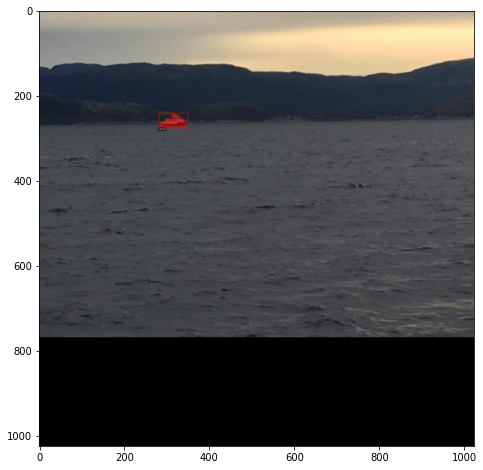

In [ ]:
import matplotlib.pyplot as plt

my_dataset_train_metadata = MetadataCatalog.get("train")
dataset_dicts = DatasetCatalog.get("train")
plt.figure(figsize = (8,8))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, :])

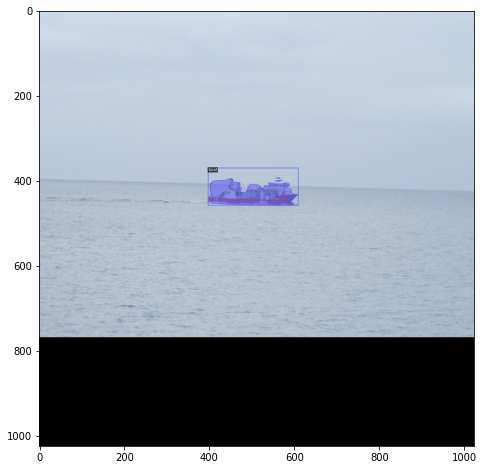

In [ ]:
import matplotlib.pyplot as plt

my_dataset_val_metadata = MetadataCatalog.get("val")
dataset_dicts = DatasetCatalog.get("val")
plt.figure(figsize = (8,8))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_val_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, :])

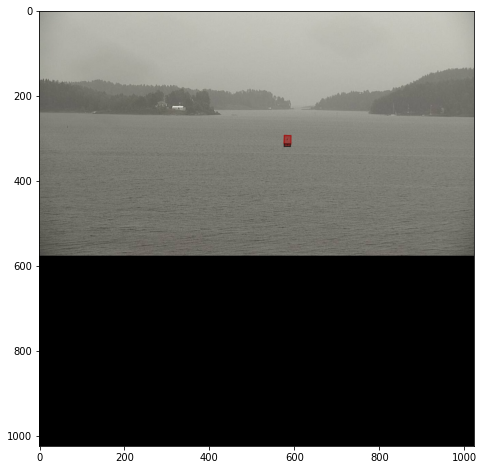

In [ ]:
import matplotlib.pyplot as plt

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")
plt.figure(figsize = (8,8))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
    vis = visualizer.draw_dataset_dict(d)
    plt.imshow(vis.get_image()[:, :, :])

# Check assigned GPU 

In [ ]:
import tensorflow as tf
tf.test.gpu_device_name()

'/device:GPU:0'

In [ ]:
from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 15308660687716258542, name: "/device:XLA_CPU:0"
 device_type: "XLA_CPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 9318509050547562128
 physical_device_desc: "device: XLA_CPU device", name: "/device:XLA_GPU:0"
 device_type: "XLA_GPU"
 memory_limit: 17179869184
 locality {
 }
 incarnation: 9945112075415738454
 physical_device_desc: "device: XLA_GPU device", name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14563024576
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 2051053646764313614
 physical_device_desc: "device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:04.0, compute capability: 7.0"]

# Set up model config and initiate training 

In [ ]:
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.config import get_cfg
from detectron2.modeling import build_model
from os import getcwd, makedirs
from detectron2.utils import comm

# Model configuration 
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml'))
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x/138205316/model_final_a3ec72.pkl" # Path pasted from model zoo online 

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Threshold for testing 
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 12
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # Boat, building

cfg.INPUT.MIN_SIZE_TRAIN = (1000,)  # Avoid re-scaling of already scaled images 
cfg.INPUT.MIN_SIZE_TEST = 1000

cfg.DATALOADER.NUM_WORKERS = 2
cfg.DATALOADER.FILTER_EMPTY_ANNOTATIONS = True
cfg.DATASETS.TRAIN = ('train',)
cfg.DATASETS.TEST = ('val',)  # For validation on training 


cfg.SOLVER.IMS_PER_BATCH = 2  # Two images per Gpu , only one GPU 
cfg.SOLVER.BASE_LR = 0.0003
cfg.SOLVER.MAX_ITER = 20000  # adjust up if val mAP is still rising, adjust down if overfit,  INCREASE FOR REAL MODEL ... 
cfg.SOLVER.CHECKPOINT_PERIOD = 3000 # 2000  # Save model every 50th iteration -> TOO OFTEN, MUST CHANGE WHEN "REAL MODEL"


cfg.TEST.EVAL_PERIOD = 300 # 300  # How many steps before evaluate - TODO INCREASE WHEN REAL ITERATIONS
# cfg.TEST.DETECTIONS_PER_IMAGE = None  CHECK AND SET THIS  

# Logging and checkpoint saving 
makedirs(cfg.OUTPUT_DIR, exist_ok=True)
setup_logger(output=cfg.OUTPUT_DIR, distributed_rank=comm.get_rank(), name="grabcut_grini_nc_1024_buildings_boats_mask_rcnn_baseline")

# checkpointer = DetectionCheckpointer(build_model(cfg), save_dir=cfg.OUTPUT_DIR)
# checkpointer.save("grini_nc_1024_faster_rcnn")  # save to output/model_999.pth
cfg.INPUT


CfgNode({'MIN_SIZE_TRAIN': (1000,), 'MIN_SIZE_TRAIN_SAMPLING': 'choice', 'MAX_SIZE_TRAIN': 1333, 'MIN_SIZE_TEST': 1000, 'MAX_SIZE_TEST': 1333, 'RANDOM_FLIP': 'horizontal', 'CROP': CfgNode({'ENABLED': False, 'TYPE': 'relative_range', 'SIZE': [0.9, 0.9]}), 'FORMAT': 'BGR', 'MASK_FORMAT': 'polygon'})

Create custom evaluator trainer

In [ ]:
#@title

import logging
from os import makedirs
from os.path import join

from detectron2.engine import DefaultTrainer
from detectron2.engine.hooks import HookBase
from detectron2.evaluation import inference_context, COCOEvaluator
from detectron2.utils.logger import log_every_n_seconds
from detectron2.data import DatasetMapper, build_detection_test_loader, build_detection_train_loader
import detectron2.utils.comm as comm
import torch
import time
import datetime
import numpy as np


class LossEvalHook(HookBase):
    def __init__(self, eval_period, model, data_loader):
        self._model = model
        self._period = eval_period
        self._data_loader = data_loader

    def _do_loss_eval(self):
        # Copying inference_on_dataset from evaluator.py
        total = len(self._data_loader)
        num_warmup = min(5, total - 1)

        start_time = time.perf_counter()
        total_compute_time = 0
        losses = []
        for idx, inputs in enumerate(self._data_loader):
            if idx == num_warmup:
                start_time = time.perf_counter()
                total_compute_time = 0
            start_compute_time = time.perf_counter()
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            total_compute_time += time.perf_counter() - start_compute_time
            iters_after_start = idx + 1 - num_warmup * int(idx >= num_warmup)
            seconds_per_img = total_compute_time / iters_after_start
            if idx >= num_warmup * 2 or seconds_per_img > 5:
                total_seconds_per_img = (time.perf_counter() - start_time) / iters_after_start
                eta = datetime.timedelta(seconds=int(total_seconds_per_img * (total - idx - 1)))
                log_every_n_seconds(
                    logging.INFO,
                    "Loss on Validation  done {}/{}. {:.4f} s / img. ETA={}".format(
                        idx + 1, total, seconds_per_img, str(eta)), n=5, )
            loss_batch = self._get_loss(inputs)
            losses.append(loss_batch)
        mean_loss = np.mean(losses)
        self.trainer.storage.put_scalar('validation_loss', mean_loss)
        comm.synchronize()

        return losses

    def _get_loss(self, data):
        # How loss is calculated on train_loop
        metrics_dict = self._model(data)
        metrics_dict = {
            k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
            for k, v in metrics_dict.items()
        }
        total_losses_reduced = sum(loss for loss in metrics_dict.values())
        return total_losses_reduced

    def after_step(self):
        next_iter = self.trainer.iter + 1
        is_final = next_iter == self.trainer.max_iter
        if is_final or (self._period > 0 and next_iter % self._period == 0):
            self._do_loss_eval()
        self.trainer.storage.put_scalars(timetest=12)


class CustomValTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, False, output_folder)

    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1, LossEvalHook(
            self.cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg, True)
            )
        ))
        return hooks

20k iterations runs below 

In [ ]:
# Run with only random flip and random crop 
trainer = CustomValTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/01 19:48:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:11, 21.4MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[12/01 19:49:05 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

Streaming output truncated to the last 5000 lines.
|:------:|:------:|:------:|:------:|:------:|:------:|
| 28.774 | 54.204 | 26.114 | 13.781 | 27.105 | 47.575 |
[12/01 21:20:56 d2.evaluation.coco_evaluation]: Per-category bbox AP: 
| category   | AP     | category   | AP     |
|:-----------|:-------|:-----------|:-------|
| building   | 19.456 | boat       | 38.092 |
Loading and preparing results...
DONE (t=0.02s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
COCOeval_opt.evaluate() finished in 0.16 seconds.
Accumulating evaluation results...
COCOeval_opt.accumulate() finished in 0.01 seconds.
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.195
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.452
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.145
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.081
 Average Precision  (AP) @

In [ ]:
# Save final results to drive, filter them later, if large run, consider zipping before saving to drive 
!cp "/content/output" -r "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_mask_rcnn_baseline" 


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

If runtime off, re-mount the drive and load tensorboard from the output folder in drive 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
saved_output_dir = "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_mask_rcnn_baseline"  

In [ ]:
# Inspect tensorflow logged events 
!find "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_mask_rcnn_baseline"     | grep tfevents

In [ ]:
tensorboard --inspect --logdir "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_mask_rcnn_baseline"  

In [16]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_mask_rcnn_baseline"     # saved_output_dir
# %tensorboard --logdir output

<IPython.core.display.Javascript object>

Plot validation and training together 

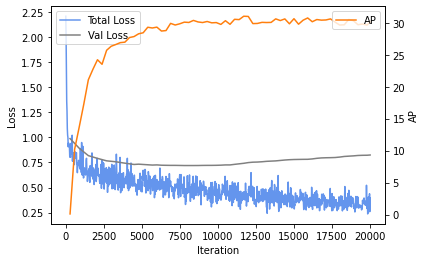

In [ ]:
import json
import matplotlib.pyplot as plt

experiment_folder =  saved_output_dir# cfg.OUTPUT_DIR

def load_json_arr(json_path):
    lines = []
    with open(json_path, 'r') as f:
        for line in f:
            lines.append(json.loads(line))
    return lines

experiment_metrics = load_json_arr(experiment_folder + '/metrics.json')

fig, ax1 = plt.subplots(facecolor='w')

color = 'tab:blue'
ax1.set_xlabel('Iteration')
ax1.set_ylabel('Loss')

ax1.plot(
    [x['iteration'] for x in experiment_metrics if 'total_loss' in x], 
    [x['total_loss'] for x in experiment_metrics if 'total_loss' in x], color="cornflowerblue", label="Total Loss")
ax1.plot(
    [x['iteration'] for x in experiment_metrics if 'validation_loss' in x], 
    [x['validation_loss'] for x in experiment_metrics if 'validation_loss' in x], color="gray", label="Val Loss")
    
ax1.tick_params(axis='y')
plt.legend(loc='upper left')

ax2 = ax1.twinx()

color = 'tab:orange'
ax2.set_ylabel('AP')
ax2.plot(
    [x['iteration'] for x in experiment_metrics if 'bbox/AP' in x], 
    [x['bbox/AP'] for x in experiment_metrics if 'bbox/AP' in x], color=color, label="AP")
ax2.tick_params(axis='y')

plt.legend(loc='upper right')
plt.show()

#Test predictions 

In [ ]:
import os
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(saved_output_dir, "model_0008999.pth") # Overfitting a lot, use the 8999 step
# cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:124: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  filter_inds = filter_mask.nonzero()


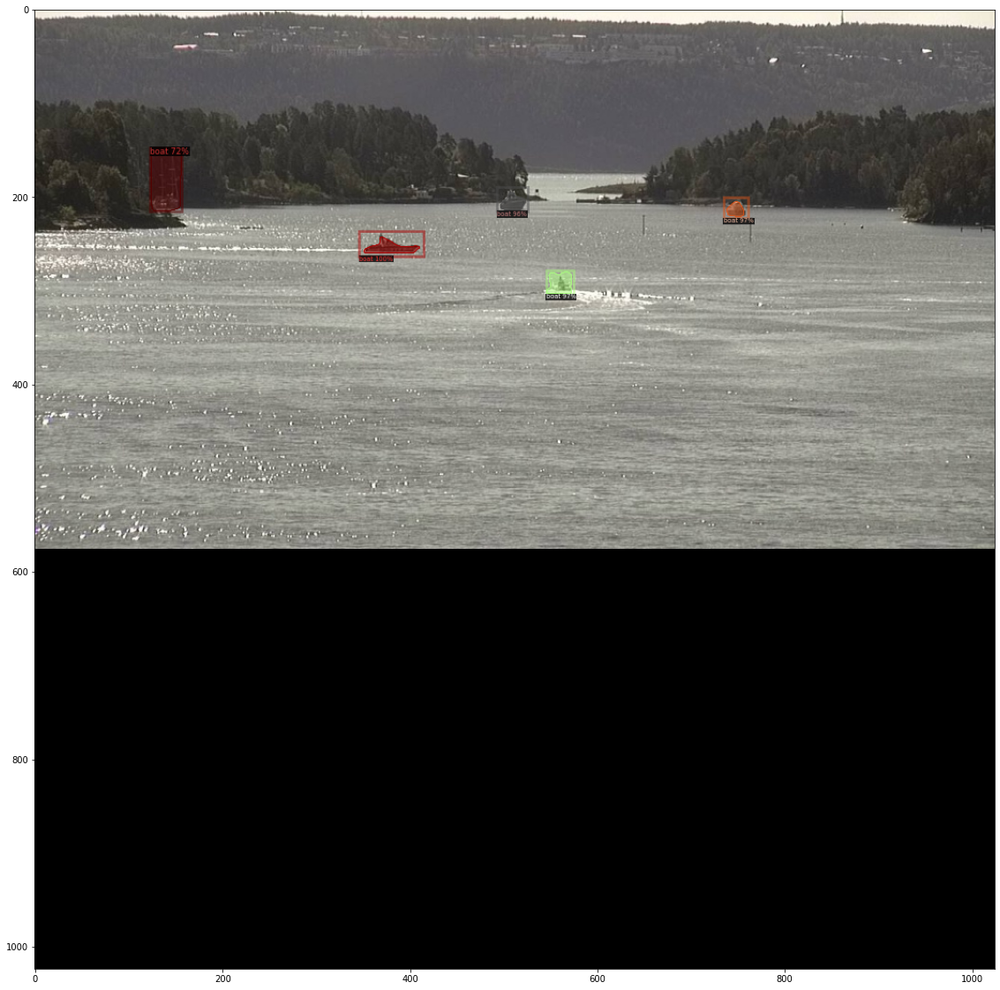

In [ ]:
import matplotlib.pyplot as plt

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")
plt.figure(figsize = (20, 20))

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    plt.imshow(out.get_image()[:, :, :])

# dataset_dicts 

#Test inference

In [15]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
makedirs('test_output', exist_ok=True)
cfg.OUTPUT_DIR = 'test_output'
cfg.MODEL.WEIGHTS = os.path.join(saved_output_dir, "model_0008999.pth")  # Best model, slightly overfitted but so much better AP it is fine 
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Threshold for testing ensure it is the same as during evaluation, lower this can give us better AP as we keep more predictions 
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("test", ("bbox","segm"), False, output_dir="./test_output/test_inference")

# Re-define trainer and load if run-time reset 
trainer = CustomValTrainer(cfg)
trainer.resume_or_load(resume=True)  # Resume from model weights overwritten above 

val_loader = build_detection_test_loader(cfg, "test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))  # Same trainer as before 
# another equivalent way to evaluate the model is to use `trainer.test`

[12/02 11:08:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [ ]:
# Copy test inference results to drive 
!cp "/content/test_output" -r "/content/drive/MyDrive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_mask_rcnn_baseline/test_inference_only"

# Prediction examples for similar images all detectors 

In [ ]:
import os 
# Samples to visualize 
sailboat = '190618_082821.jpg'
large_boat_distance = '190620_075745.jpg'
rainy_boat_in_horizon = 'IMG_2510.jpg'

small_kayak_close = 'extra_kayak_axis0005.jpg'
small_boat_distance_sunny = 'selected_08_07_frame2166.jpg'
more_boats_horizon = 'selected_08_04_frame1730.jpg'
scattered_small_boats = 'selected_08_10_frame0330.jpg'
grini_comparison_photo = 'IMG_2075.jpg'
extremely_difficult = 'selected_06_14_axis0051.jpg'
amsterdam = '190628_175252.jpg'
singapore_horizon_boats = 'IMG_9244.jpg'

sample_names = [sailboat, large_boat_distance, rainy_boat_in_horizon, small_kayak_close, small_boat_distance_sunny, more_boats_horizon,  scattered_small_boats, grini_comparison_photo, 
                extremely_difficult, amsterdam, singapore_horizon_boats]
sample_paths = [os.path.join(test_imgs, sample_name) for sample_name in sample_names]


[12/02 11:00:32 d2.data.datasets.coco]: Loaded 380 images in COCO format from /content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_test.json
Found matching image of name 190618_082821.jpg
Found matching image of name 190620_075745.jpg
Found matching image of name 190628_175252.jpg
Found matching image of name extra_kayak_axis0005.jpg
Found matching image of name IMG_2075.jpg
Found matching image of name IMG_2510.jpg
Found matching image of name IMG_9244.jpg
Found matching image of name selected_06_14_axis0051.jpg
Found matching image of name selected_08_04_frame1730.jpg
Found matching image of name selected_08_07_frame2166.jpg
Found matching image of name selected_08_10_frame0330.jpg


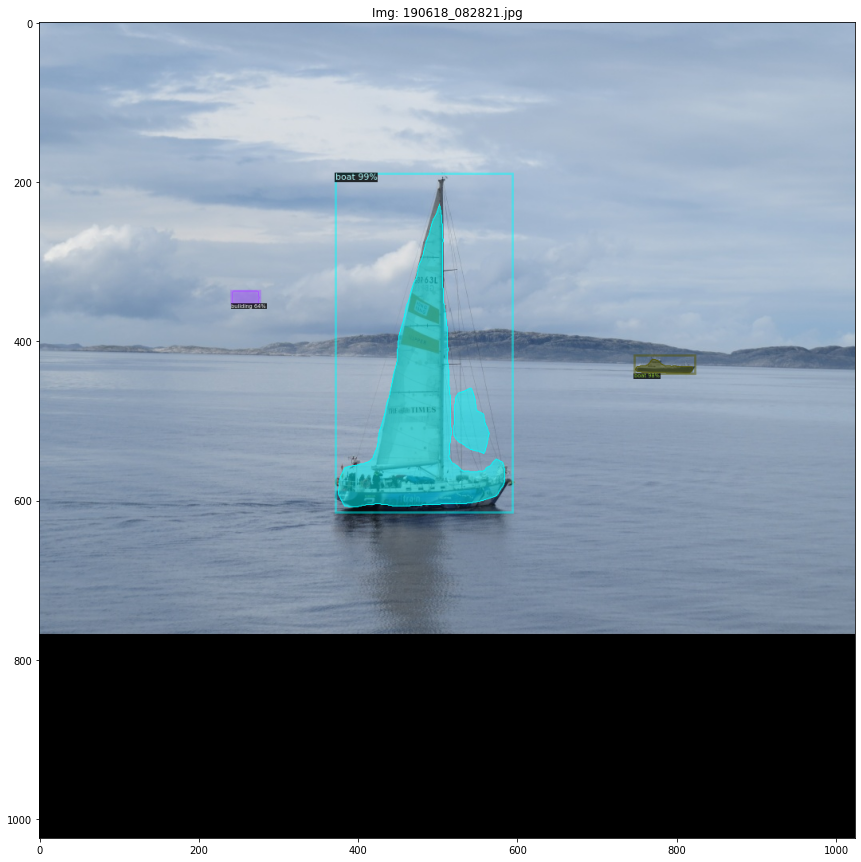

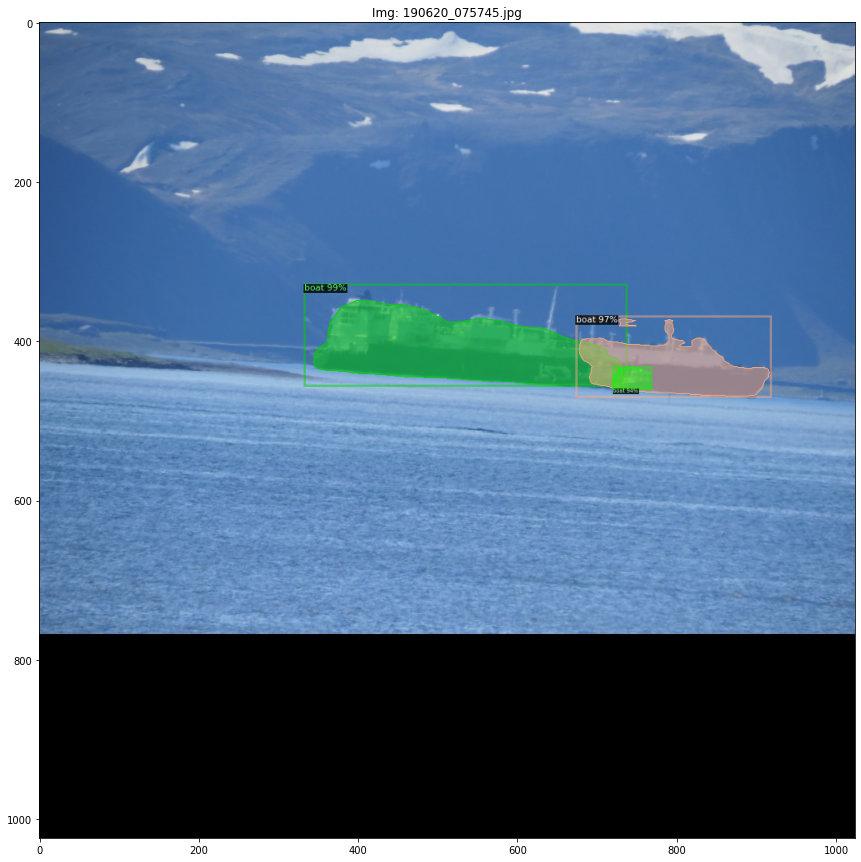

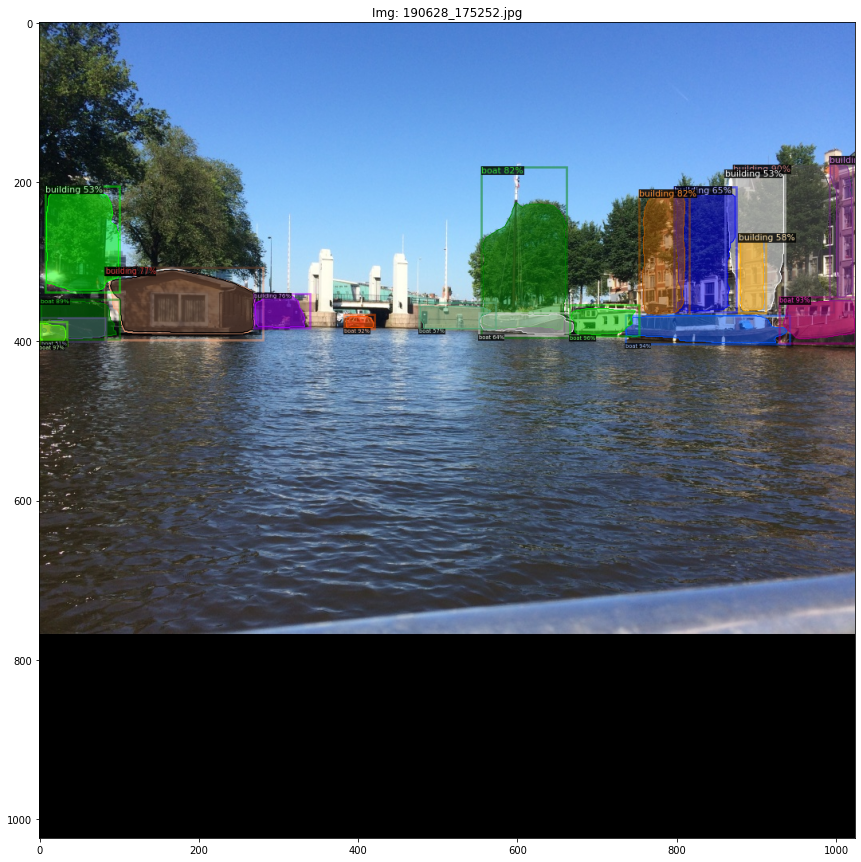

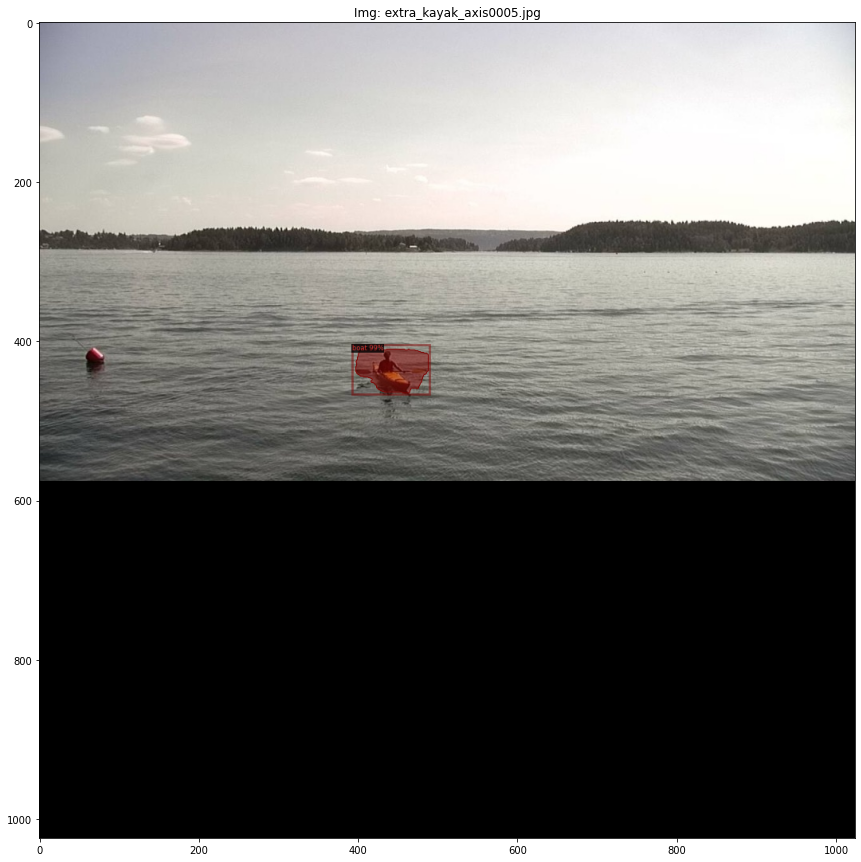

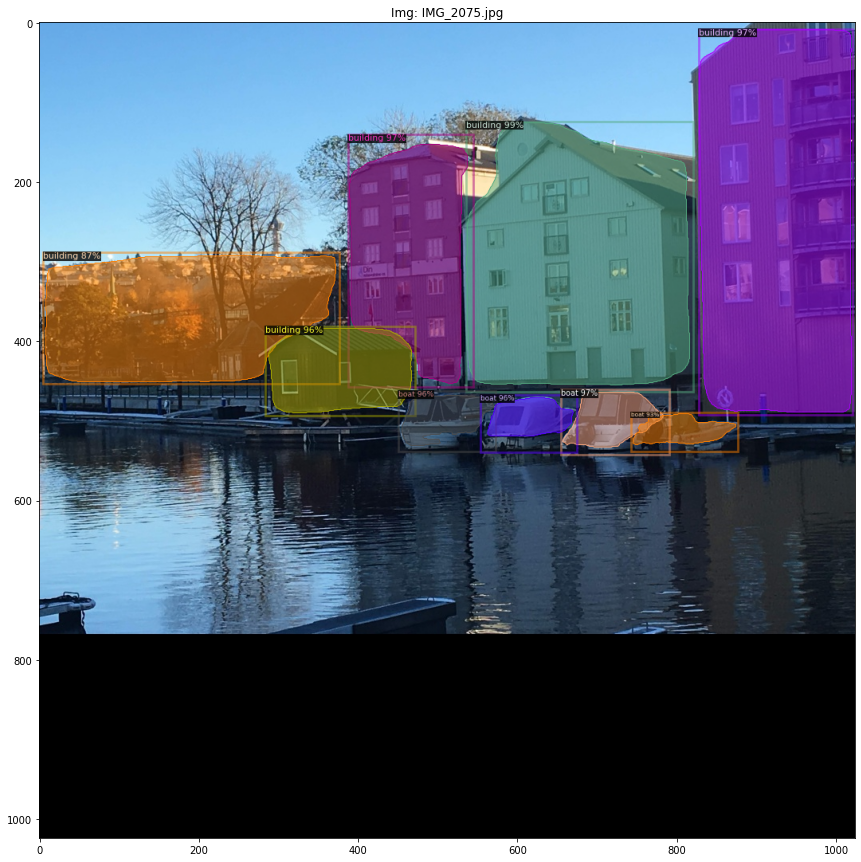

...

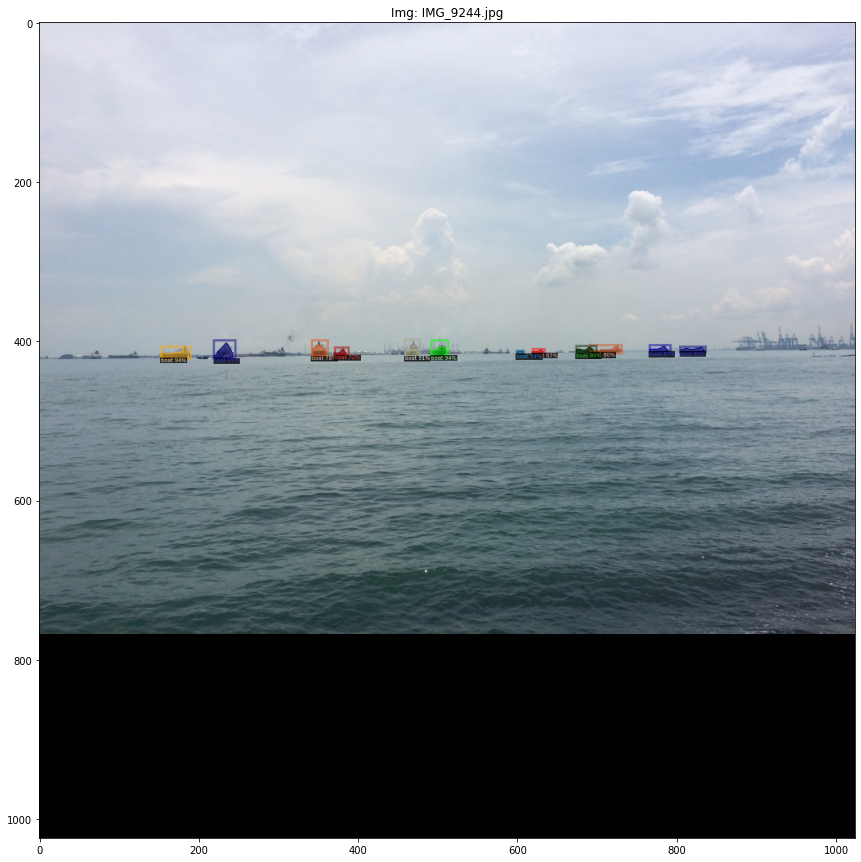

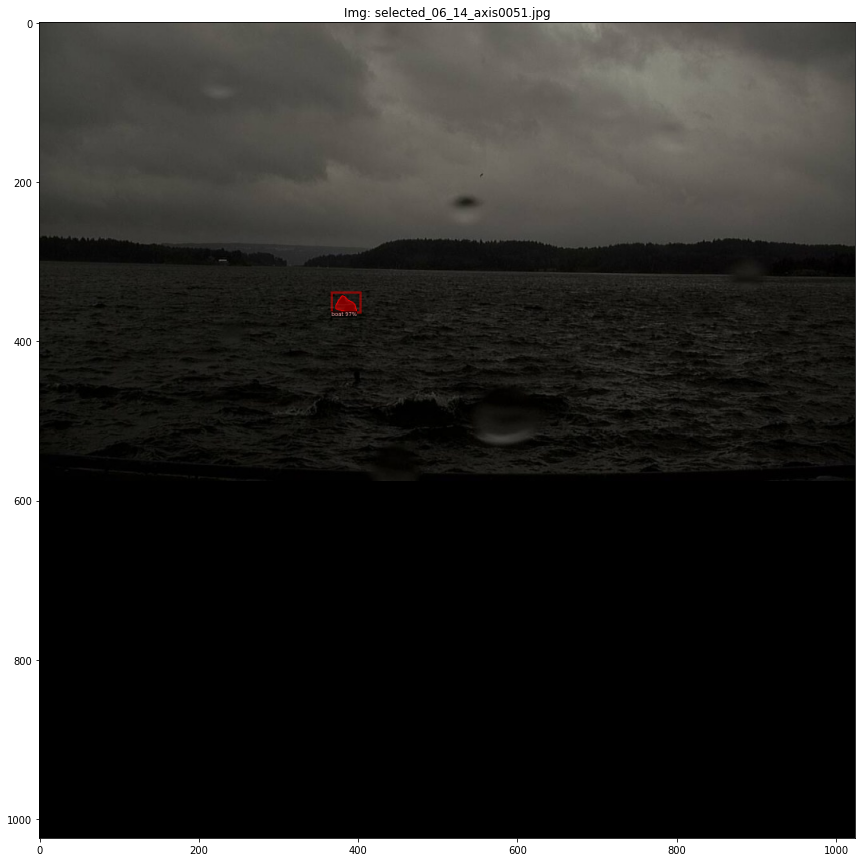

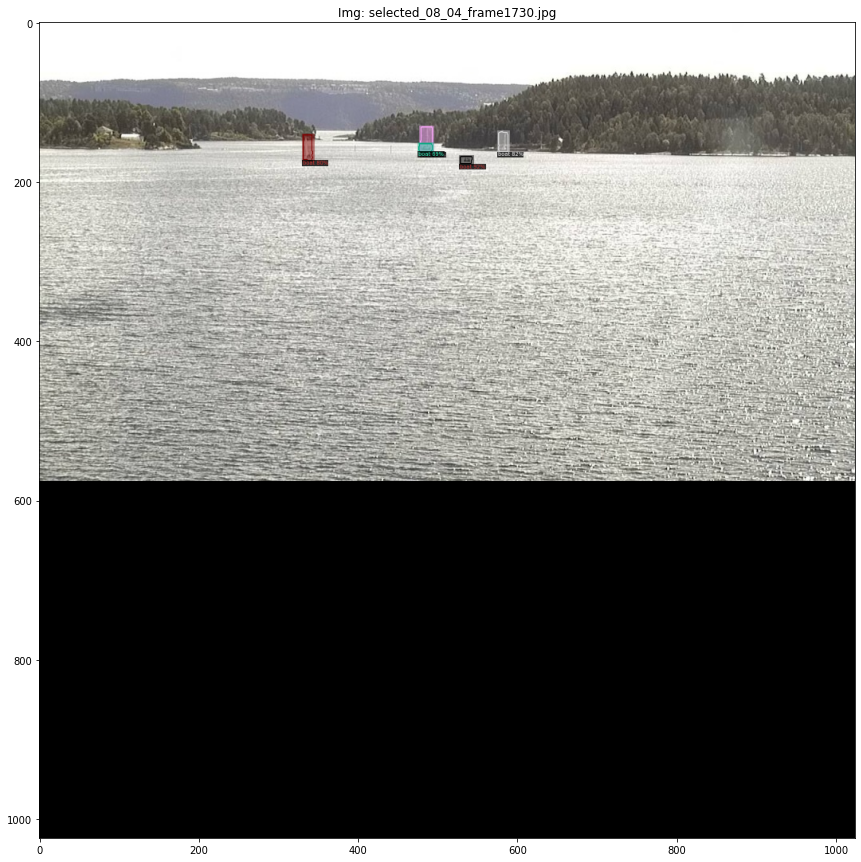

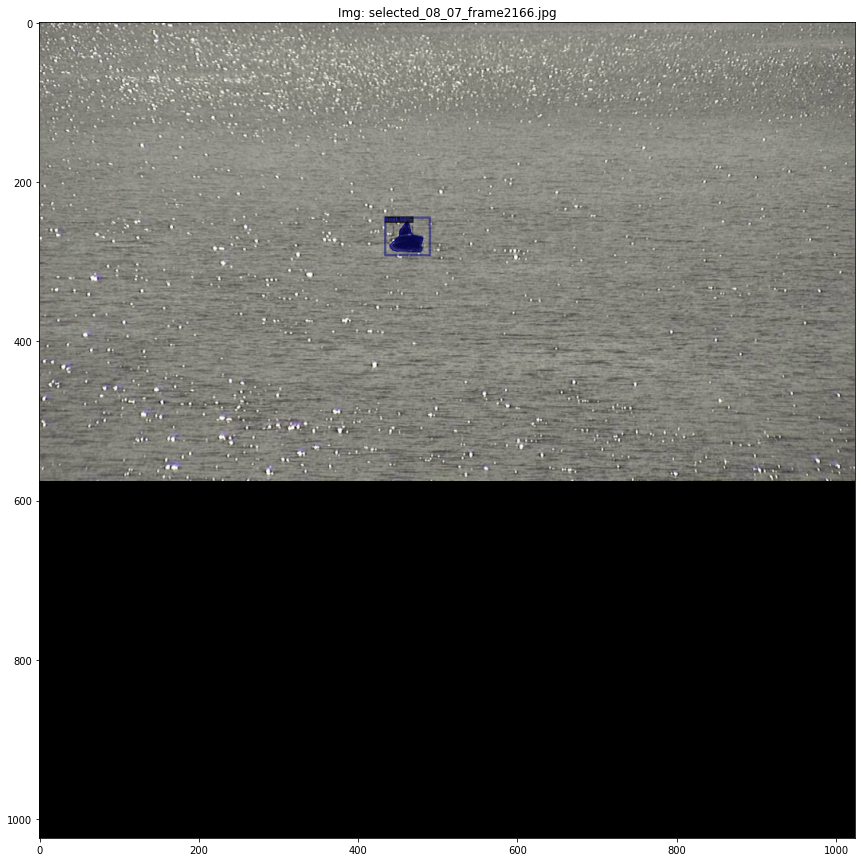

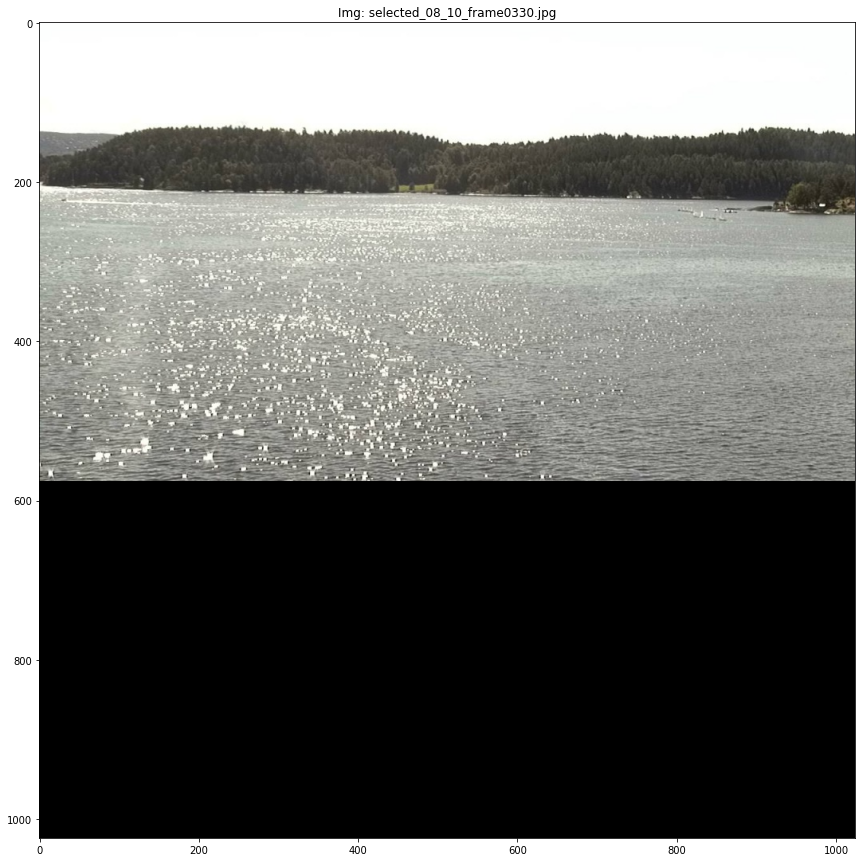

In [ ]:
import matplotlib.pyplot as plt
import os

cfg.MODEL.WEIGHTS = os.path.join(saved_output_dir, "model_0008999.pth") # We take model from step 18k here 
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")

# counter = 0
# fig, ax = plt.subplots(len(sample_paths), figsize = (12*len(sample_paths), 12*len(sample_paths)))
for container in (dataset_dicts):
    if container['file_name'] in sample_paths:
      fig = plt.figure(figsize =(15,15))
      print('Found matching image of name {}'.format(os.path.basename(container['file_name'])))      
      img = cv2.imread(container['file_name'])
      outputs = predictor(img)
      visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
      out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
      plt.imshow(out.get_image()[:, :, :])
      plt.title('Img: {}'.format(os.path.basename(container['file_name'])))
      # ax[counter].imshow(out.get_image()[:, :, :])
      # ax[counter].set_title('Img: {}'.format(os.path.basename(container['file_name'])))
      # counter +=1 

# dataset_dicts 

# Draw ground truths 

[12/02 10:32:15 d2.data.datasets.coco]: Loaded 380 images in COCO format from /content/drive/My Drive/project_training/grini_all_bb_nc_merged_1024_baseline/grabcut_test.json
Found matching image of name 190618_082821.jpg
Found matching image of name 190620_075745.jpg
Found matching image of name 190628_175252.jpg
Found matching image of name extra_kayak_axis0005.jpg
Found matching image of name IMG_2075.jpg
Found matching image of name IMG_2510.jpg
Found matching image of name IMG_9244.jpg
Found matching image of name selected_06_14_axis0051.jpg
Found matching image of name selected_08_04_frame1730.jpg
Found matching image of name selected_08_07_frame2166.jpg
Found matching image of name selected_08_10_frame0330.jpg


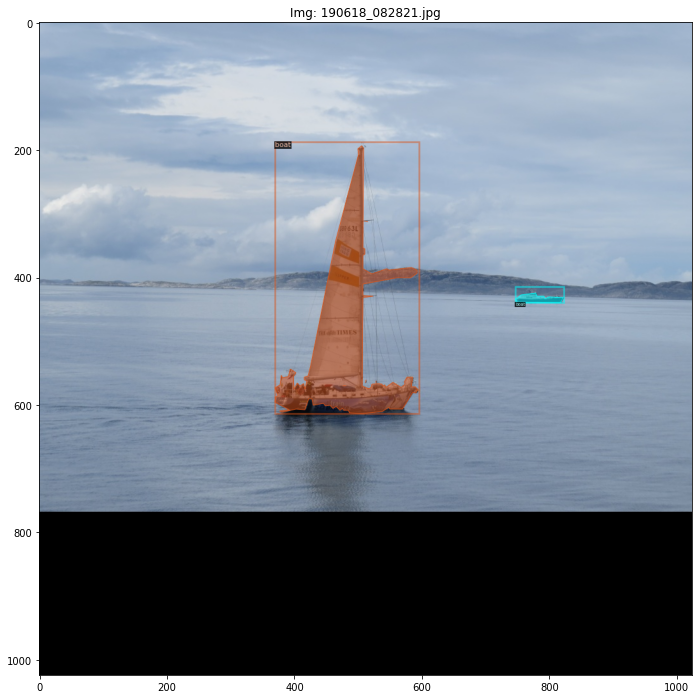

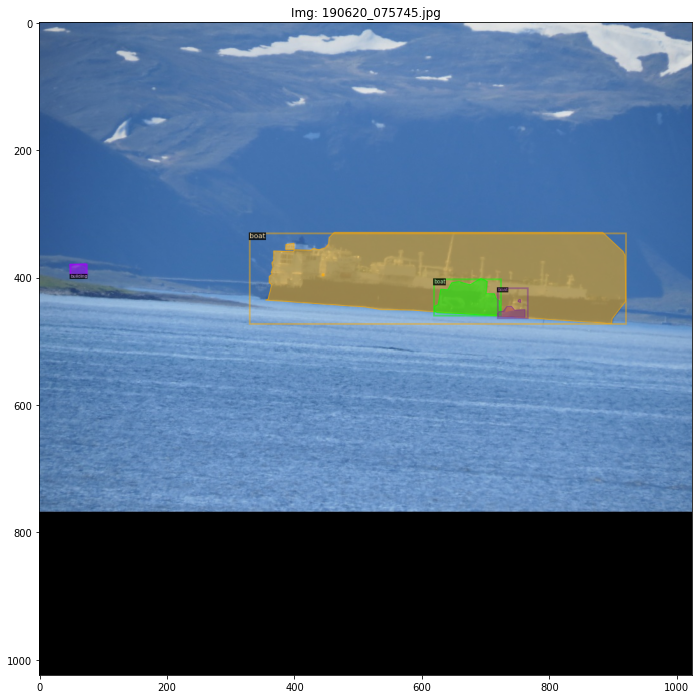

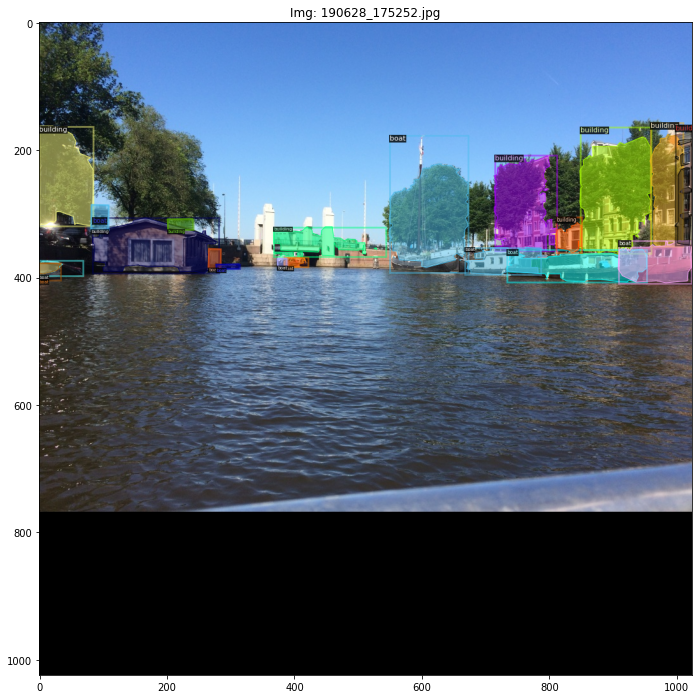

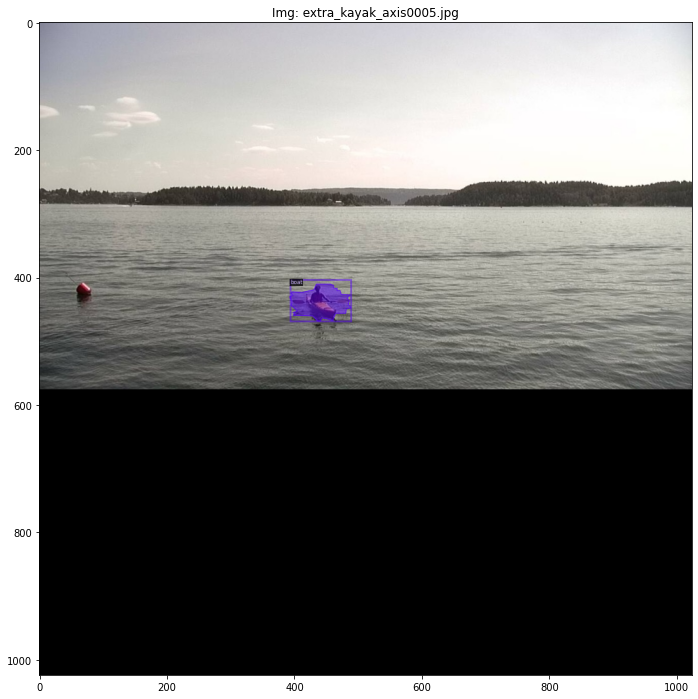

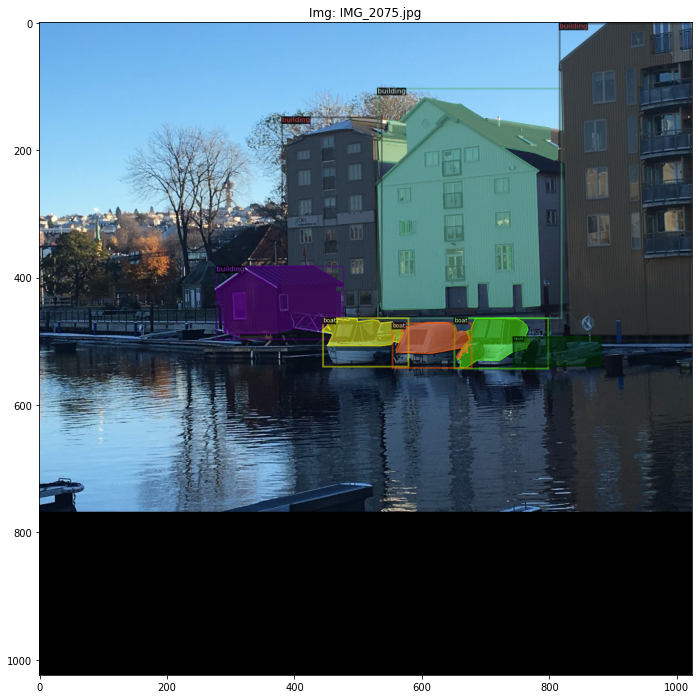

...

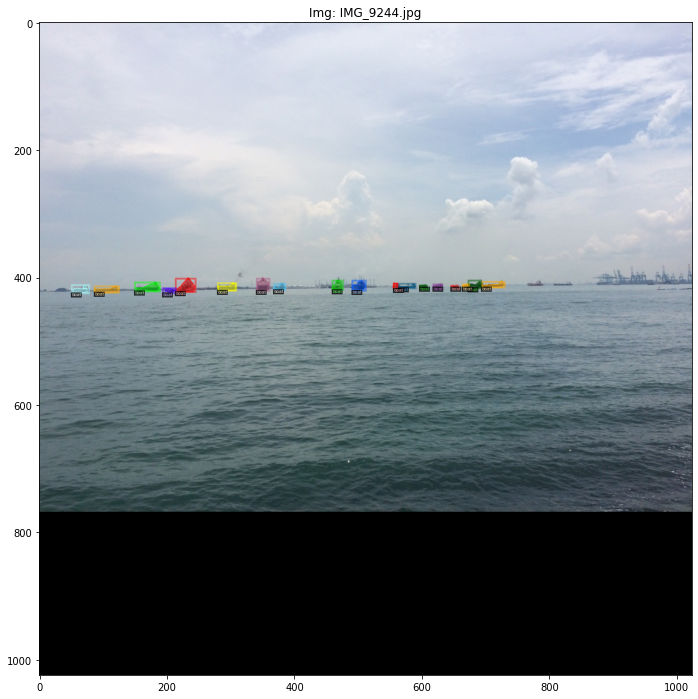

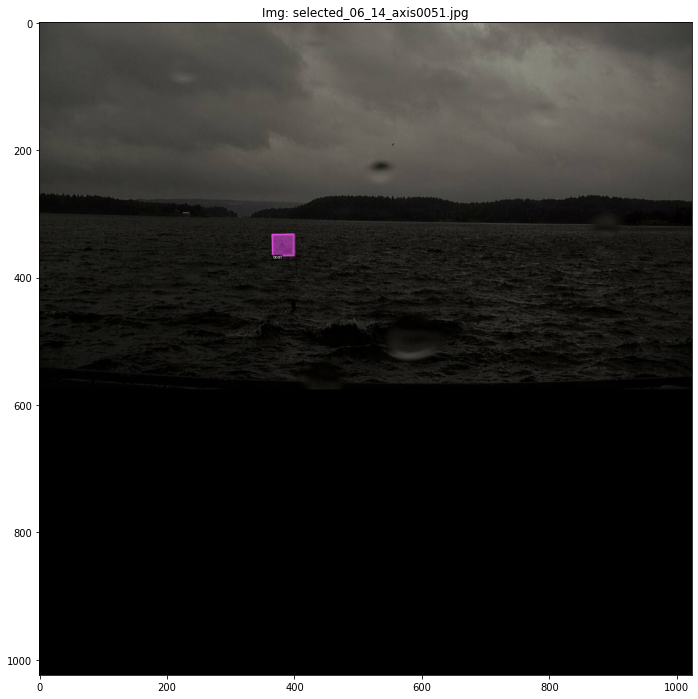

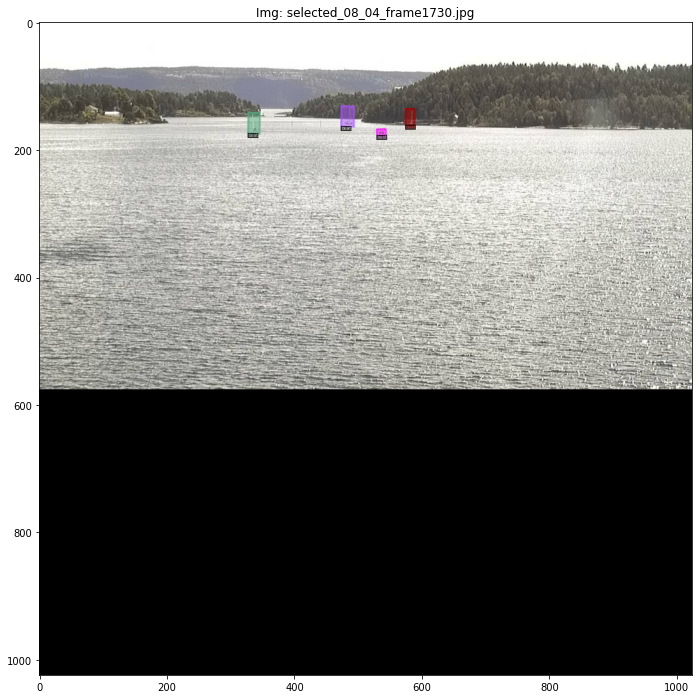

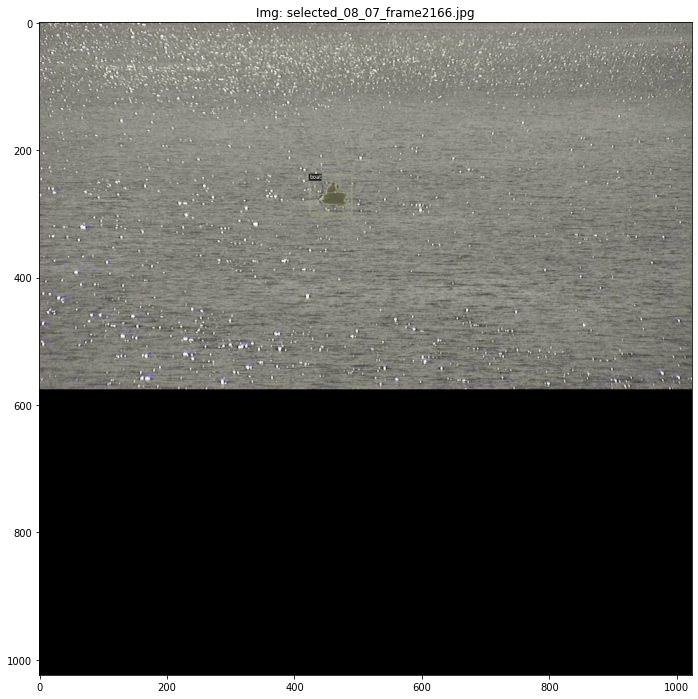

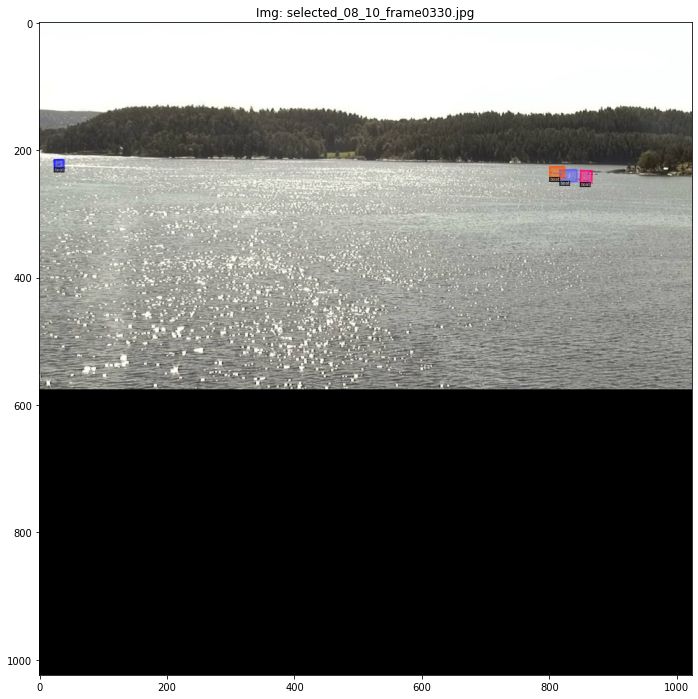

In [ ]:
import matplotlib.pyplot as plt

my_dataset_test_metadata = MetadataCatalog.get("test")
dataset_dicts = DatasetCatalog.get("test")


for container in (dataset_dicts):
    if container['file_name'] in sample_paths:
      fig = plt.figure(figsize =(12,12))
      print('Found matching image of name {}'.format(os.path.basename(container['file_name'])))      
      img = cv2.imread(container['file_name'])      
      visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_test_metadata, scale=1)
      vis = visualizer.draw_dataset_dict(container)
      plt.imshow(vis.get_image()[:, :, :])
      plt.title('Img: {}'.format(os.path.basename(container['file_name'])))
